## Sim Demo

### Imports

In [8]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
from env.imports import *

In [10]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn


<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [11]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 5.3%
RAM Usage: 8.2%
Available RAM: 924.4G
Total RAM: 1007.0G
52.4G


In [12]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB


In [13]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


In [14]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

Additional models to save

Number of components for 95% variance PCA: 54
X shape: (179, 7380)
X_pca shape: (179, 54)
Y_sc shape: (179, 179)
Y_sc_spectralL shape: (179, 183)
Y_sc_spectralA shape: (179, 183)
Y_fc shape: (179, 179)
Coordinates shape: (179, 3)
Y shape (179, 179)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: f7lg28e0
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/f7lg28e0
Initialized sweep with ID: f7lg28e0
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.0, 'epochs': 70}


  warnings.warn(



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB


  warnings.warn(



Best val loss so far at epoch 1: 0.0641
Epoch 5/70, Train Loss: 0.1050, Val Loss: 0.2003, Time: 1.76s
Epoch 10/70, Train Loss: 0.0619, Val Loss: 0.1101, Time: 1.78s
Best val loss so far at epoch 14: 0.0631
Best val loss so far at epoch 15: 0.0611
Epoch 15/70, Train Loss: 0.0453, Val Loss: 0.0611, Time: 1.78s
Best val loss so far at epoch 16: 0.0351
Best val loss so far at epoch 18: 0.0277
Epoch 20/70, Train Loss: 0.0342, Val Loss: 0.0391, Time: 1.84s
Best val loss so far at epoch 21: 0.0066
Epoch 25/70, Train Loss: 0.0276, Val Loss: 0.0228, Time: 1.85s
Best val loss so far at epoch 30: 0.0043
Epoch 30/70, Train Loss: 0.0216, Val Loss: 0.0043, Time: 1.80s
Epoch 35/70, Train Loss: 0.0169, Val Loss: 0.0098, Time: 1.80s
Epoch 40/70, Train Loss: 0.0134, Val Loss: 0.0257, Time: 1.81s
Epoch 45/70, Train Loss: 0.0107, Val Loss: 0.0287, Time: 1.85s
Epoch 50/70, Train Loss: 0.0088, Val Loss: 0.0164, Time: 1.81s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.035571


  warnings.warn(stats.ConstantInputWarning(msg))



Saved best model to models/saved_models/best_smt_model_full.pt

Early stopping triggered at epoch 55. Restoring best model with Val Loss: 0.0043, Pearson Correlation: nan


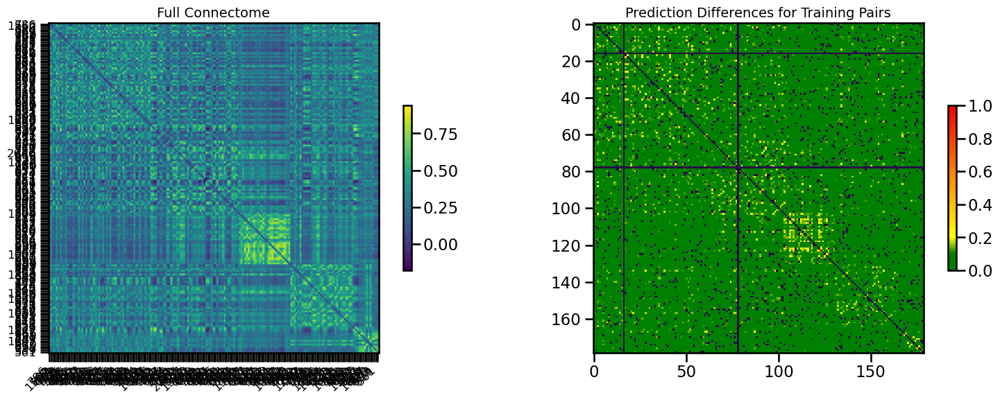

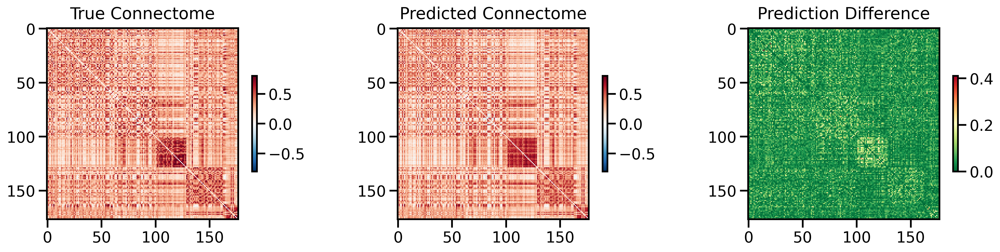

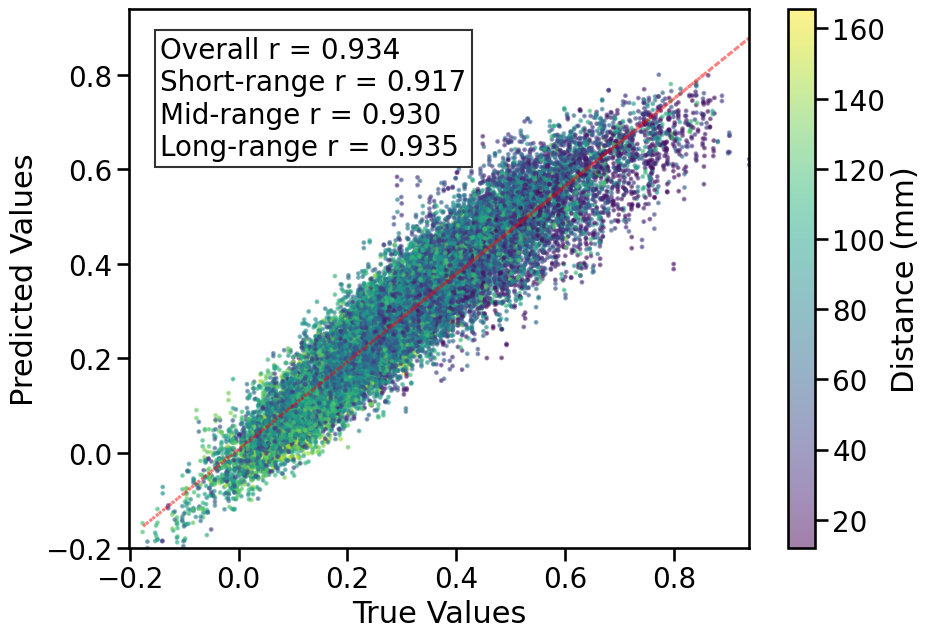

  warnings.warn(stats.ConstantInputWarning(msg))



No distance-based correlations for this model


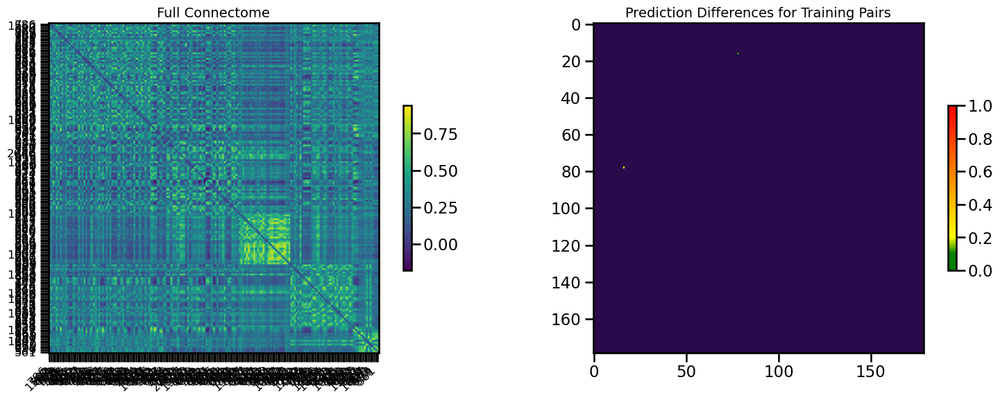

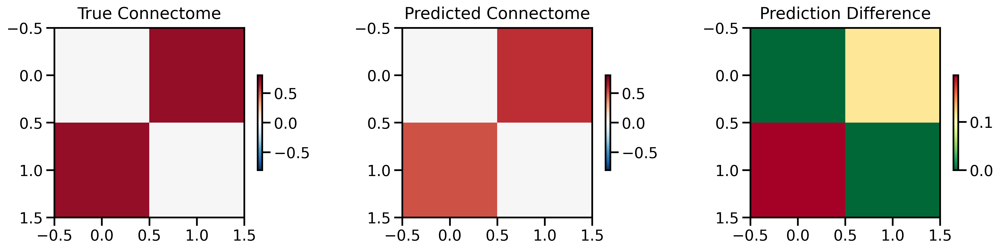

No scatter plot visualization for this model


AttributeError: 'Metrics' object has no attribute 'short_r'

<Figure size 1000x700 with 0 Axes>

In [15]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='iPA_183',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='none'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 105
X shape: (345, 7380)
X_pca shape: (345, 105)
Y_sc shape: (345, 345)
Y_sc_spectralL shape: (345, 391)
Y_sc_spectralA shape: (345, 391)
Y_fc shape: (345, 345)
Coordinates shape: (345, 3)
Y shape (345, 345)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: n66149w8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/n66149w8
Initialized sweep with ID: n66149w8


  warnings.warn(



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.0, 'epochs': 70}
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.0407
Best val loss so far at epoch 2: 0.0204
Best val loss so far at epoch 3: 0.0197
Epoch 5/70, Train Loss: 0.0359, Val Loss: 0.0206, Time: 6.81s
Best val loss so far at epoch 7: 0.0182
Best val loss so far at epoch 8: 0.0163
Epoch 10/70, Train Loss: 0

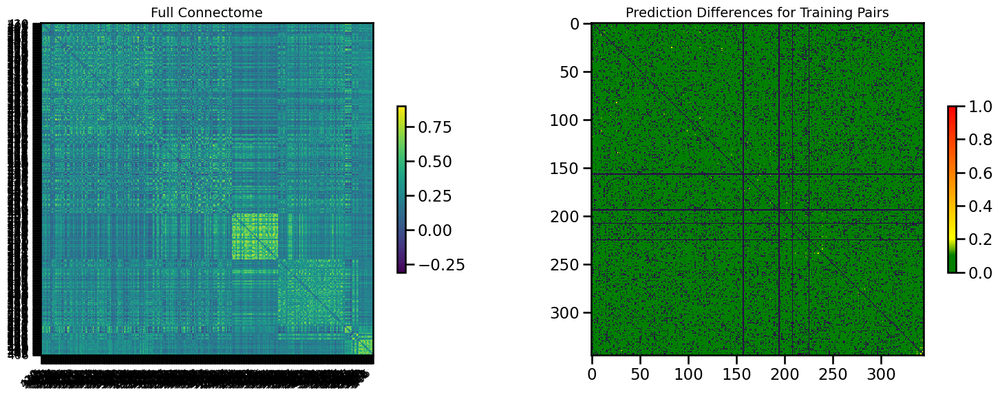

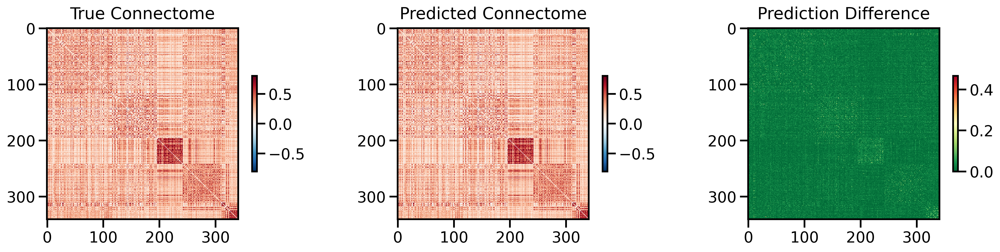

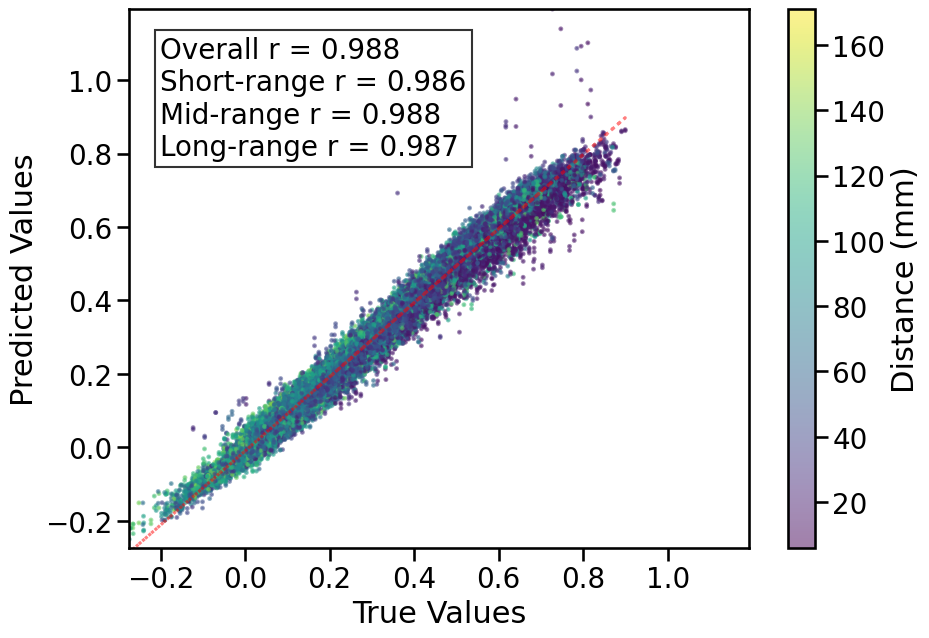

No distance-based correlations for this model


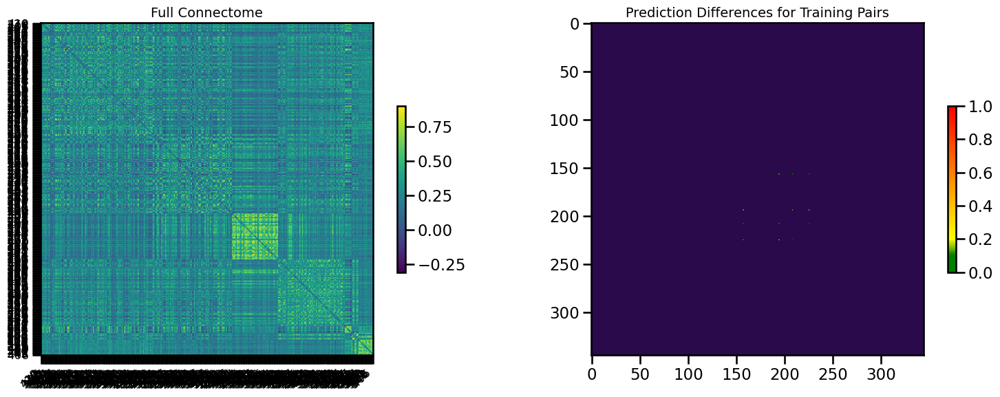

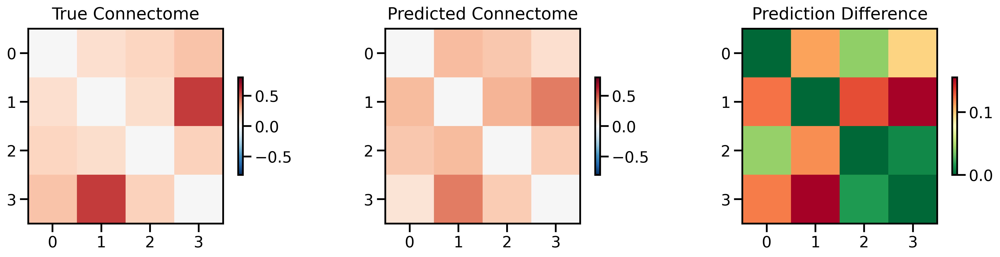

No scatter plot visualization for this model


AttributeError: 'Metrics' object has no attribute 'short_r'

<Figure size 1000x700 with 0 Axes>

In [16]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='iPA_391',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='none'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 178
X shape: (562, 7380)
X_pca shape: (562, 178)
Y_sc shape: (562, 562)
Y_sc_spectralL shape: (562, 729)
Y_sc_spectralA shape: (562, 729)
Y_fc shape: (562, 562)
Coordinates shape: (562, 3)
Y shape (562, 562)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 562w92kn
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/562w92kn
Initialized sweep with ID: 562w92kn


  warnings.warn(



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.0, 'epochs': 70}
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0145
Best val loss so far at epoch 2: 0.0130
Best val loss so far at epoch 5: 0.0122
Epoch 5/70, Train Loss: 0.0141, Val Loss: 0.0122, Time: 18.84s
Epoch 10/70, Train Loss: 0.0048, Val Loss: 0.0147, Time: 19.31s
Epoch 15/70, Train Loss: 0.0027, Val Loss

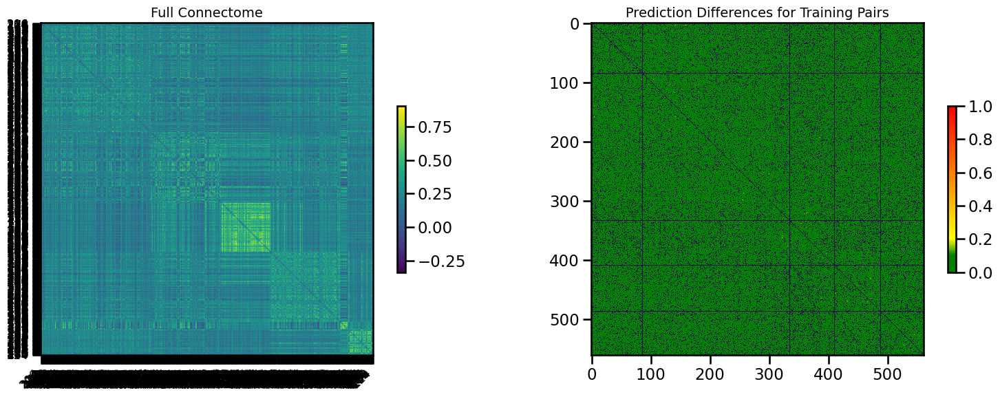

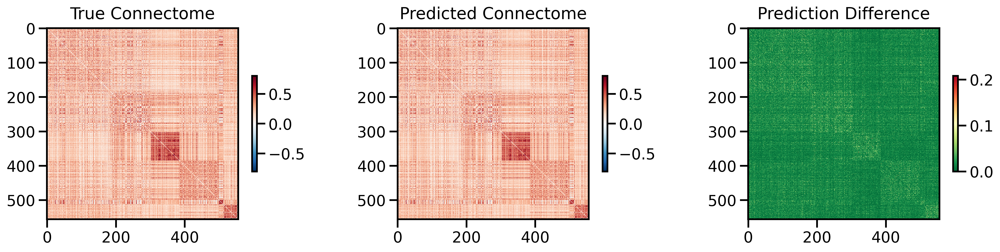

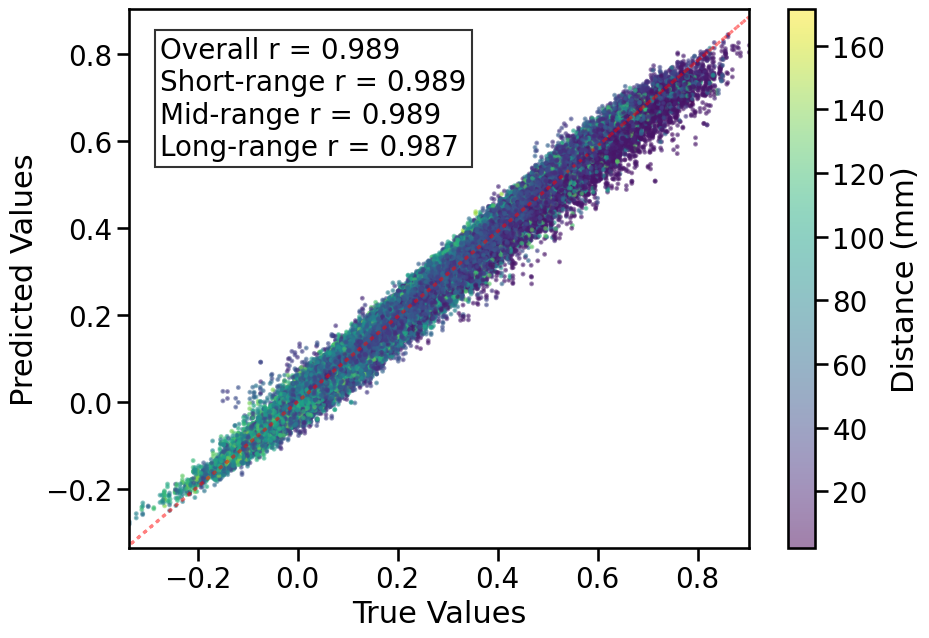

  warnings.warn(stats.ConstantInputWarning(msg))



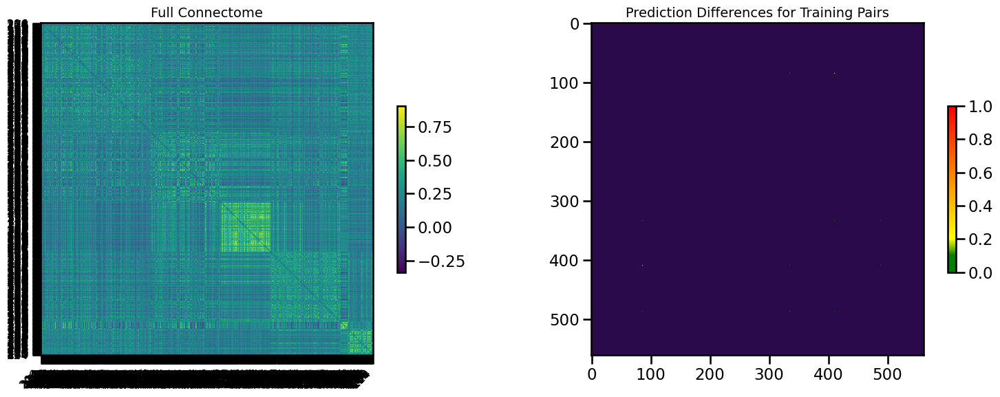

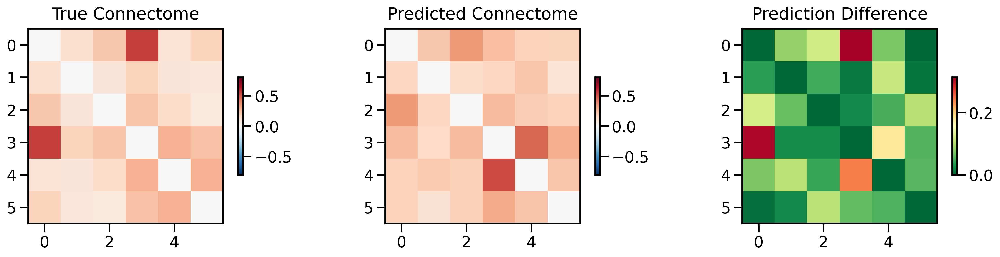

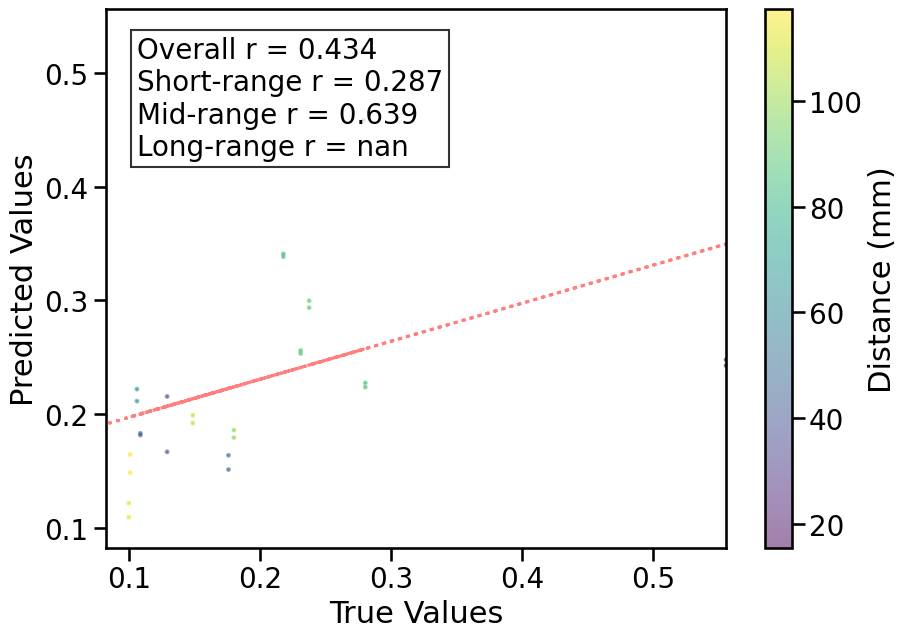


TRAIN METRICS: {'mse': 0.00045313477, 'mae': 0.015961176, 'r2': 0.977830485055923, 'pearson_r': 0.9893428926959148, 'short_r': 0.9888314492084946, 'mid_r': 0.9885045623185084, 'long_r': 0.9869383882657146, 'geodesic_distance': 13.696337191540488}
TEST METRICS: {'mse': 0.013569481, 'mae': 0.08494544, 'r2': -0.009505104851440738, 'pearson_r': 0.4336827439724086, 'short_r': 0.2873509220044309, 'mid_r': 0.6391534253158173, 'long_r': nan, 'geodesic_distance': 3.6936661171259257}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'use_alibi': True, 'batch_size': 512, 'aug_prob': 0.0, 'epochs': 70}


  warnings.warn(



1
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.0, 'epochs': 70}
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0281
Best val loss so far at epoch 2: 0.0174
Best val loss so far at epoch 4: 0.0156


In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='iPA_729',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='none'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Randomly shuffled gene expression MLP

permuting gene expression
Number of components for 95% variance PCA: 27
permuting gene expression
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: m6w5kdxz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/m6w5kdxz
Initialized sweep with ID: m6w5kdxz
2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}


  warnings.warn(



Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0365
Best val loss so far at epoch 3: 0.0331
Best val loss so far at epoch 4: 0.0328
Best val loss so far at epoch 5: 0.0323
Epoch 5/100, Train Loss: 0.0610, Val Loss: 0.0323, Time: 3.54s
Best val loss so far at epoch 7: 0.0321
Best val loss so far at epoch 10: 0.0321
Epoch 10/100, Train Loss: 0.0379, Val Loss: 0.0321, Time: 3.70s
Best val loss so far at epoch 13: 0.0319
Epoch 15/100, Train Loss: 0.0345, Val Loss: 0.0324, Time: 3.65s
Epoch 20/100, Train Loss: 0.0339, Val Loss: 0.0320, Time: 3.53s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.037428
Epoch 25/100, Train Loss: 0.0312, Val Loss: 0.0334, Time: 3.83s
Epoch 30/100, Train Loss: 0.0276, Val Loss: 0.0441, Time: 3.64s
Epoch 35/100, Train Loss: 0.0240, Val Loss: 0.0442, Time: 4.47s
Epoch 40/100, Train Loss: 0.0213, Val Loss: 0.0485, Time: 4.25s
Epoch 45/100, Train Loss: 0.0

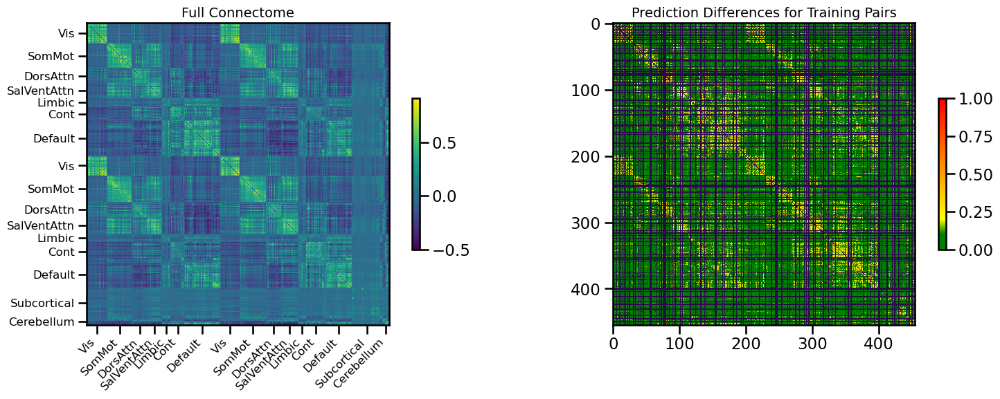

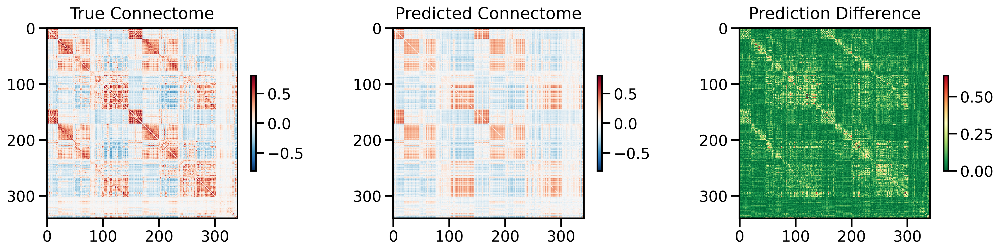

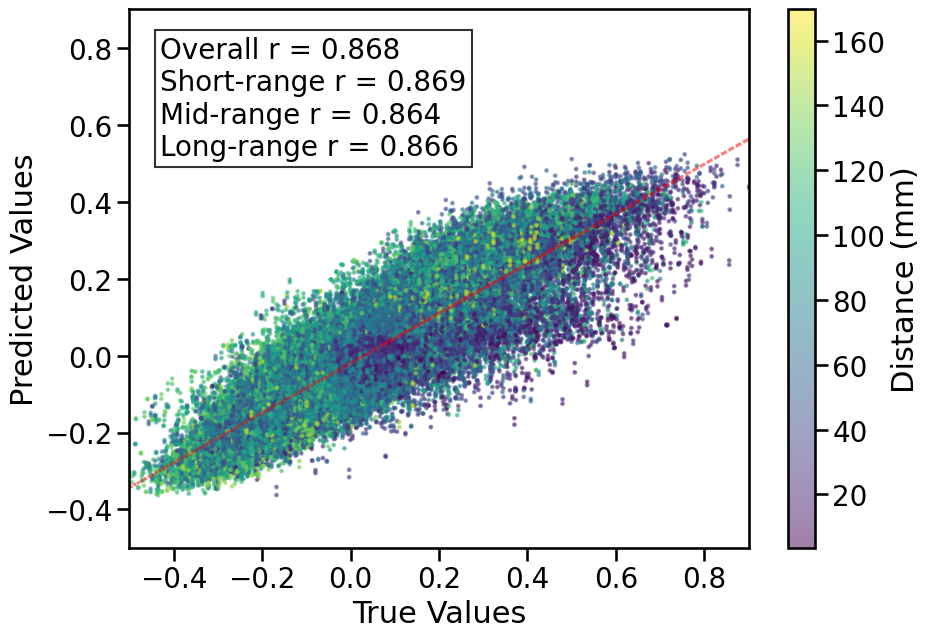

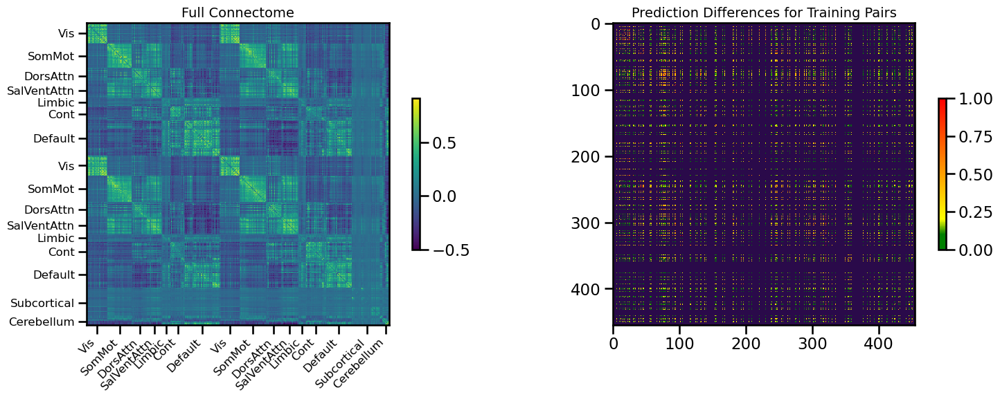

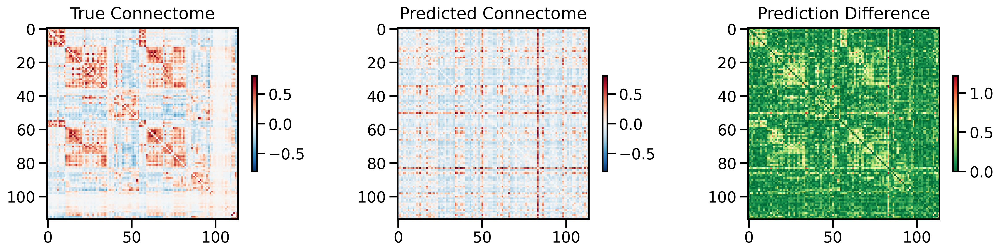

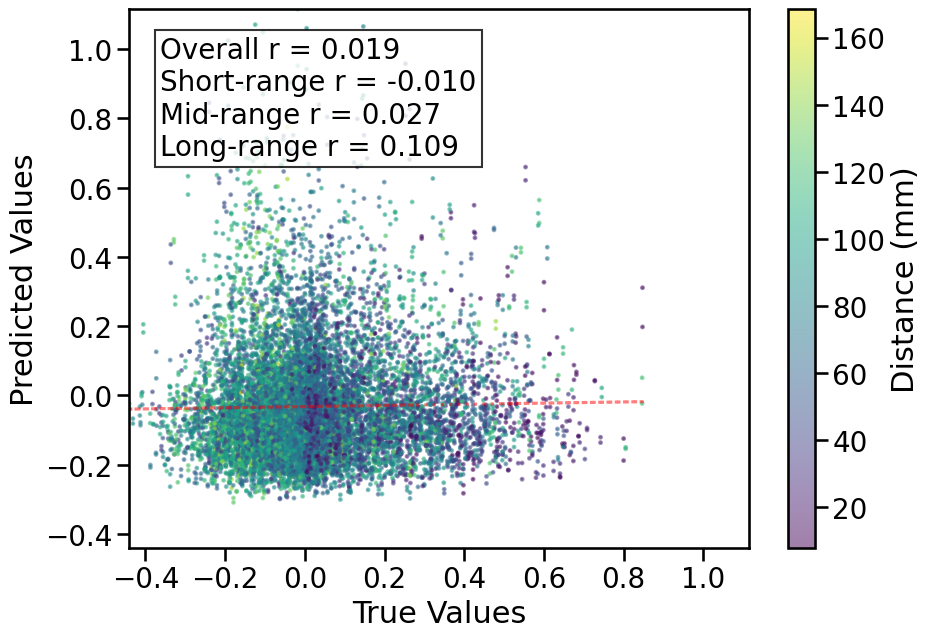


TRAIN METRICS: {'mse': 0.009669758, 'mae': 0.069457926, 'r2': 0.7194649925067675, 'pearson_r': 0.867631977971135, 'short_r': 0.868700930438899, 'mid_r': 0.8637222466020968, 'long_r': 0.865948411677938, 'geodesic_distance': 30.627582038130807}
TEST METRICS: {'mse': 0.059400655, 'mae': 0.18250531, 'r2': -0.8565124646371636, 'pearson_r': 0.018830197457245977, 'short_r': -0.009900608335068766, 'mid_r': 0.026822519563895867, 'long_r': 0.10859394630686255, 'geodesic_distance': 24.256654919336235}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 34.9%
RAM Usage: 8.5%
Available RAM: 921.3G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 439.03 seconds (7.32 minutes)


19962

In [12]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='random', 
              use_folds=[0])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Euclidean only MLP

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: m05sfy6p
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/m05sfy6p
Initialized sweep with ID: m05sfy6p


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 6, 'binarize': False, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 169729
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0285
Best val loss so far at epoch 2: 0.0250
Best val loss so far at epoch 3: 0.0240
Best val loss so far at epoch 4: 0.0238
Best val loss so far at epoch 5: 0.0232
Epoch 5/125, Train Loss: 0.0339, Val Loss: 0.0232, Time: 1.52s
Best val loss so far at epoch 6: 0.0230
Best val loss so far at epoch 8: 0.0229
Best val loss so far at epoch 9: 0.0226
Epoch 10/125, Train Loss: 0.0251, Val Loss: 0.0227, Time: 1.54s
Best val loss so far at epoch 11: 0.0224
Best val loss so far at epoch 12: 0.0224
Best val loss so far at epoch 13: 0.0221
Best val loss so far at epoch 15: 0.0218
Epoch 15/125, Train Loss: 0.0228, Val Loss: 0.0218, Time: 1.54s
Best val loss 

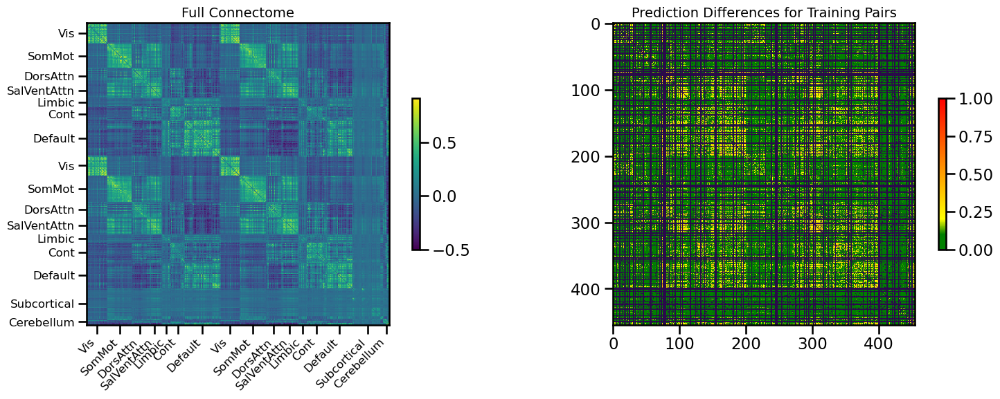

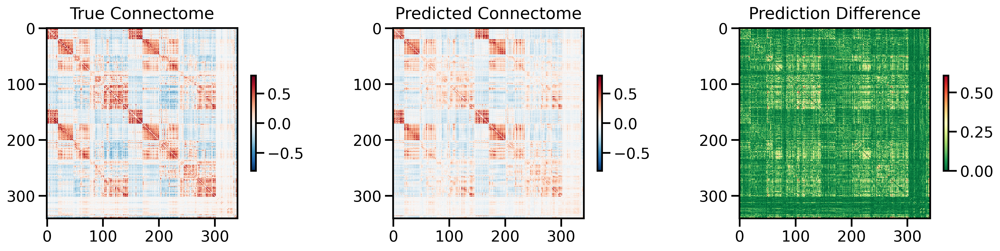

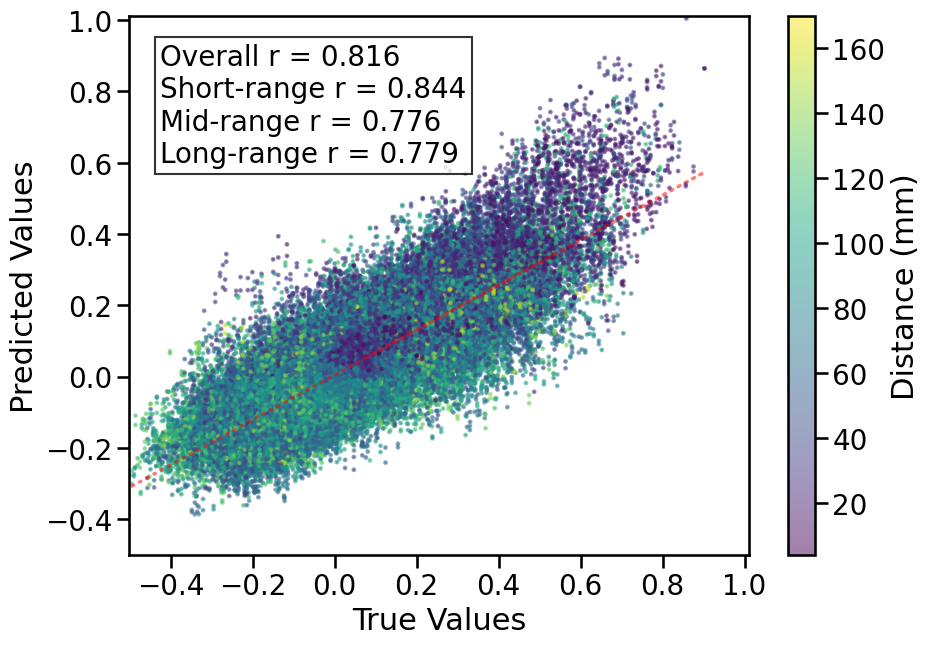

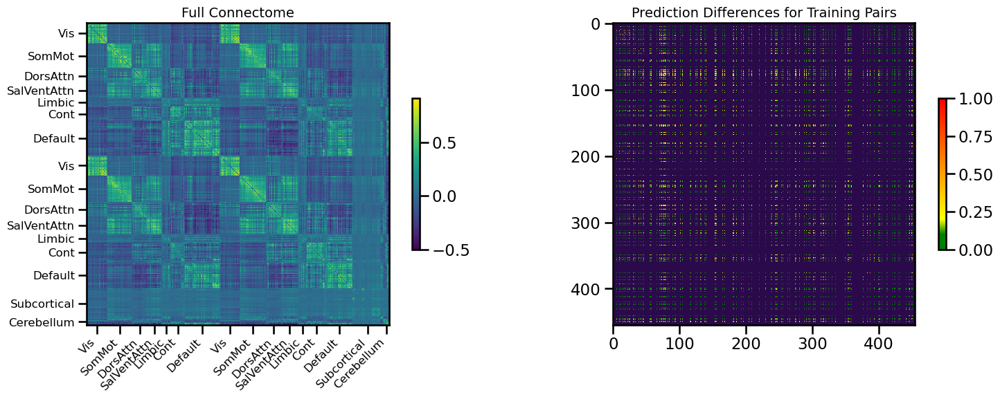

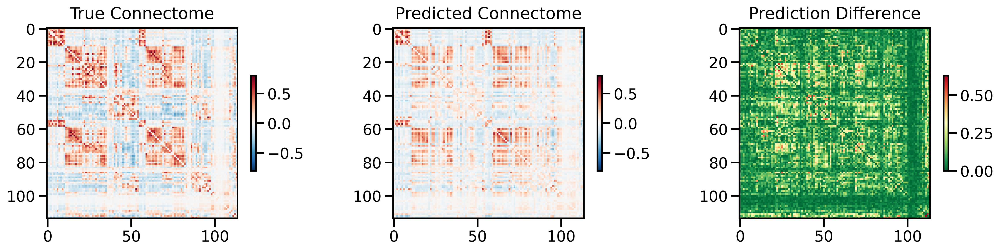

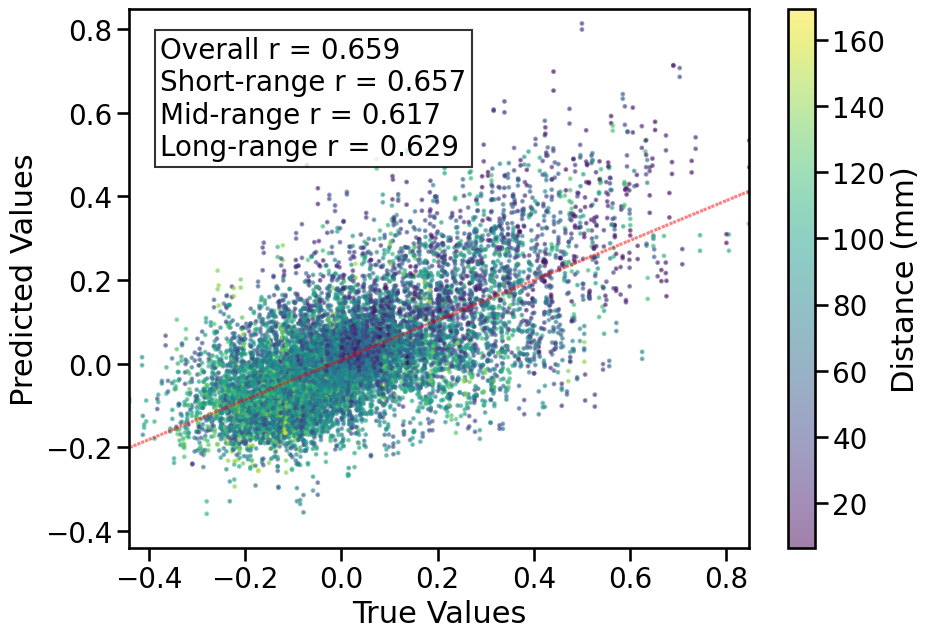


TRAIN METRICS: {'mse': 0.011372566, 'mae': 0.077751964, 'r2': 0.6642885550369728, 'pearson_r': 0.816262154629323, 'short_r': 0.8438996734711587, 'mid_r': 0.7763388257539859, 'long_r': 0.7786315540381922, 'geodesic_distance': 19.962906380460172}
TEST METRICS: {'mse': 0.018647088, 'mae': 0.09903725, 'r2': 0.4304353976337234, 'pearson_r': 0.6593615114501462, 'short_r': 0.6571357813734727, 'mid_r': 0.6166947162887965, 'long_r': 0.6293518416918168, 'geodesic_distance': 12.96485815407195}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 125}
CPU Usage: 2.1%
RAM Usage: 8.2%
Available RAM: 924.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 229.84 seconds (3.83 minutes)


37043

In [9]:
single_sim_run(
              feature_type=[{'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none', 
              use_folds=[0])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: b4nb9eip
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/b4nb9eip
Initialized sweep with ID: b4nb9eip
2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 70}


  warnings.warn(



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB


  warnings.warn(



Best val loss so far at epoch 1: 0.0336
Best val loss so far at epoch 2: 0.0291
Best val loss so far at epoch 3: 0.0276
Best val loss so far at epoch 4: 0.0266
Best val loss so far at epoch 5: 0.0262
Epoch 5/70, Train Loss: 0.0720, Val Loss: 0.0262, Time: 9.40s
Best val loss so far at epoch 6: 0.0262
Best val loss so far at epoch 7: 0.0258
Best val loss so far at epoch 9: 0.0244
Best val loss so far at epoch 10: 0.0240
Epoch 10/70, Train Loss: 0.0486, Val Loss: 0.0240, Time: 8.77s
Best val loss so far at epoch 11: 0.0229
Best val loss so far at epoch 12: 0.0216
Best val loss so far at epoch 14: 0.0204
Epoch 15/70, Train Loss: 0.0382, Val Loss: 0.0214, Time: 8.40s
Epoch 20/70, Train Loss: 0.0340, Val Loss: 0.0227, Time: 8.65s
Epoch 25/70, Train Loss: 0.0288, Val Loss: 0.0215, Time: 8.45s
Best val loss so far at epoch 28: 0.0201
Epoch 30/70, Train Loss: 0.0219, Val Loss: 0.0226, Time: 8.24s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.022526
Epoch 35/70, Train Loss: 0.0222, Val Loss: 

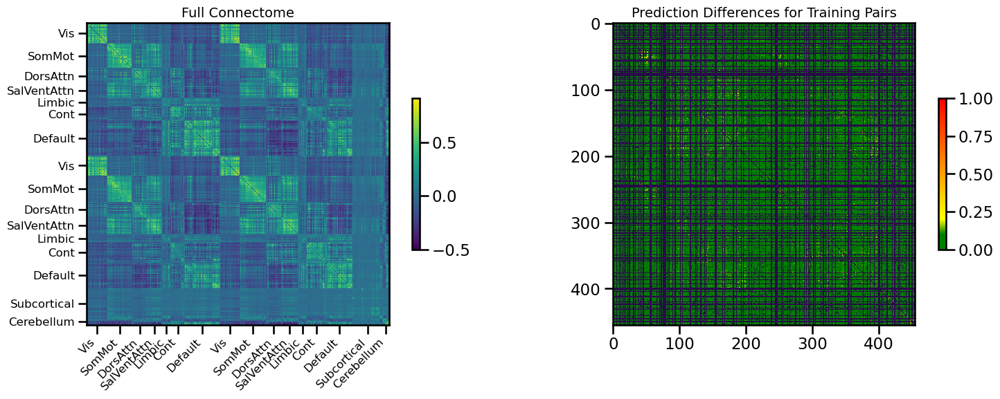

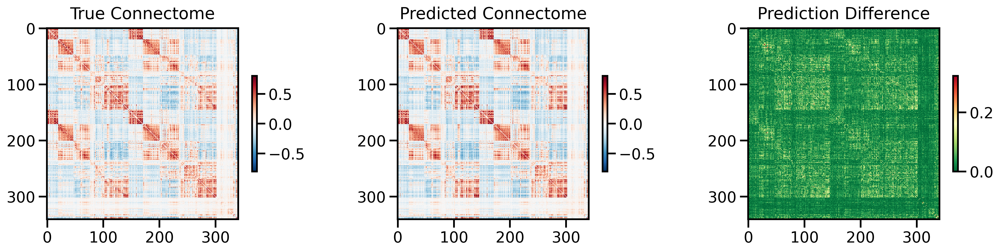

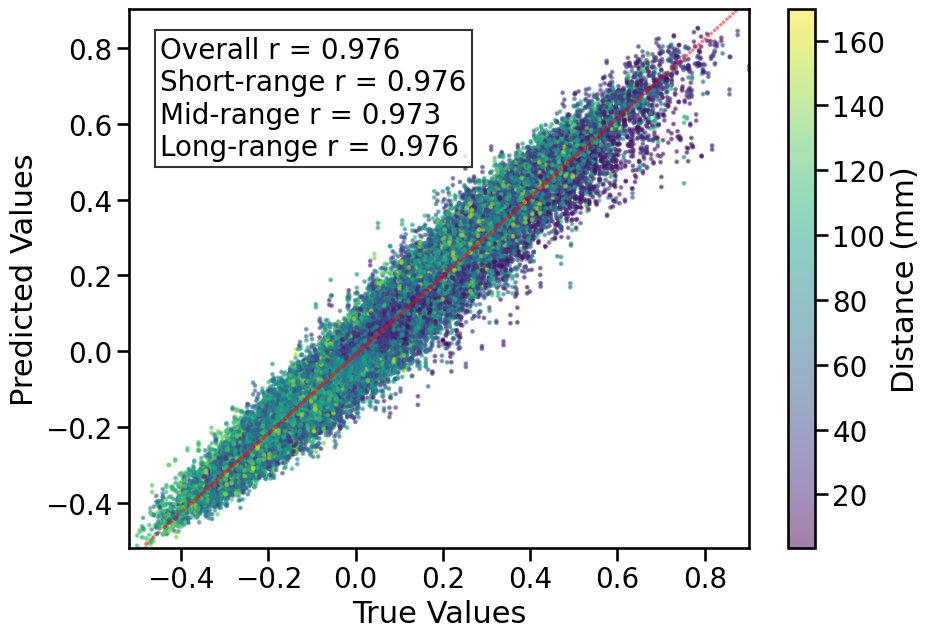

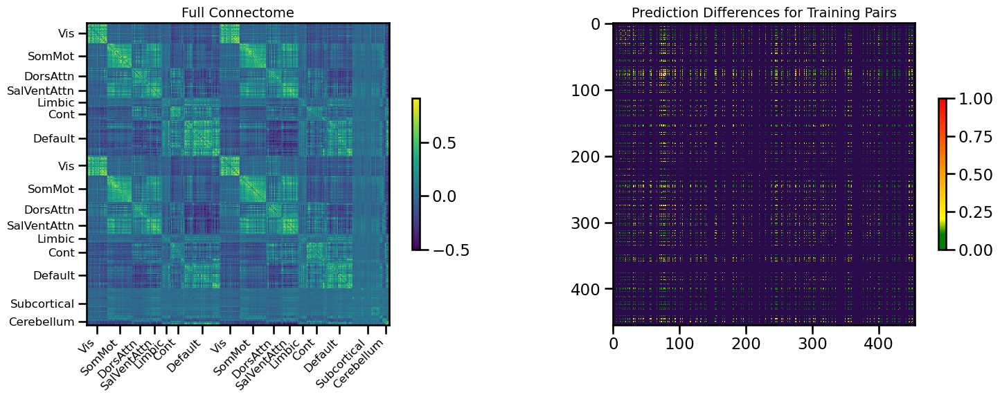

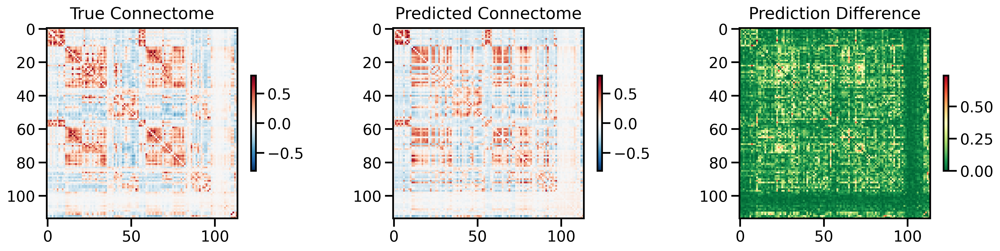

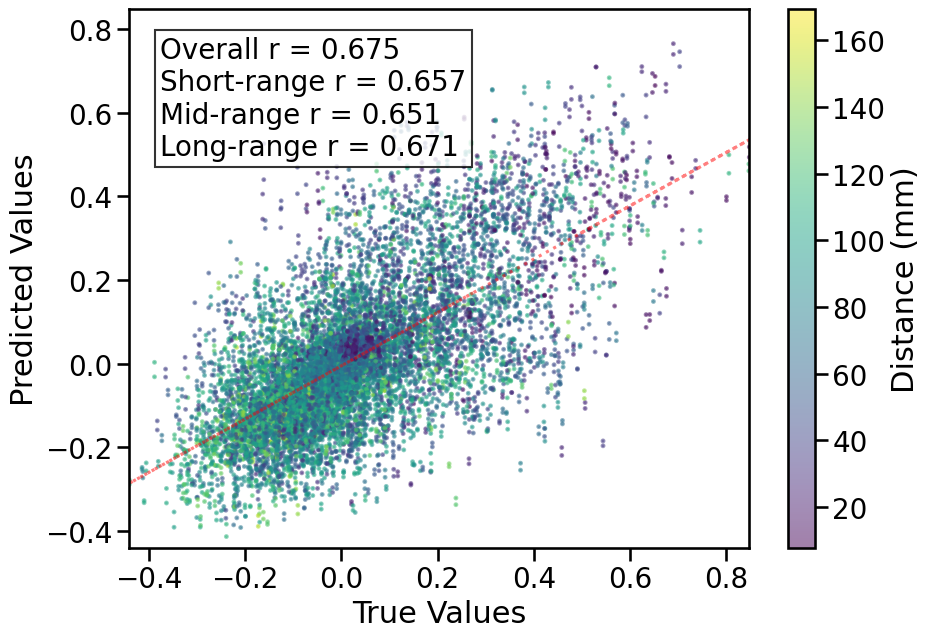


TRAIN METRICS: {'mse': 0.0019809292, 'mae': 0.033014383, 'r2': 0.9423263426752491, 'pearson_r': 0.975790251300094, 'short_r': 0.9763257130643008, 'mid_r': 0.9730071451525794, 'long_r': 0.9756581695743288, 'geodesic_distance': 14.044334118416458}
TEST METRICS: {'mse': 0.020105962, 'mae': 0.10107331, 'r2': 0.3779605699132036, 'pearson_r': 0.6753297303773499, 'short_r': 0.6566308701097924, 'mid_r': 0.6513879296321217, 'long_r': 0.6705355995499378, 'geodesic_distance': 11.631782042079038}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'cls_init': 'spatial_learned', 'use_alibi': True, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 70, 'aug_prob': 0.45}
CPU Usage: 2.2%
RAM Usage: 9.3%
Available RAM: 913.3G
Total RAM: 100

49047

In [8]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[0])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

MLP with euclidean and randomly shuffled gene expression

permuting gene expression
Number of components for 95% variance PCA: 27
permuting gene expression
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
feature_name:  euclidean
processing_type:  None
features ['transcriptome', 'euclidean']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ksw35r35
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ksw35r35
Initialized sweep with ID: ksw35r35


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14766, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3814145
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0338
Best val loss so far at epoch 2: 0.0295
Best val loss so far at epoch 3: 0.0289
Best val loss so far at epoch 4: 0.0281
Best val loss so far at epoch 5: 0.0277
Epoch 5/100, Train Loss: 0.0431, Val Loss: 0.0277, Time: 3.69s
Best val loss so far at epoch 7: 0.0275
Best val loss so far at epoch 9: 0.0274
Best val loss so far at epoch 10: 0.0273
Epoch 10/100, Train Loss: 0.0310, Val Loss: 0.0273, Time: 3.67s
Best val loss so far at epoch 11: 0.0272
Best val loss so far at epoch 13: 0.0271
Epoch 15/100, Train Loss: 0.0290, Val Loss: 0.0272, Time: 3.68s
Epoch 20/100, Train Loss: 0.0234, Val Loss: 0.0309, Time: 3.60s
Epoch 25/100, Train Loss: 0.018

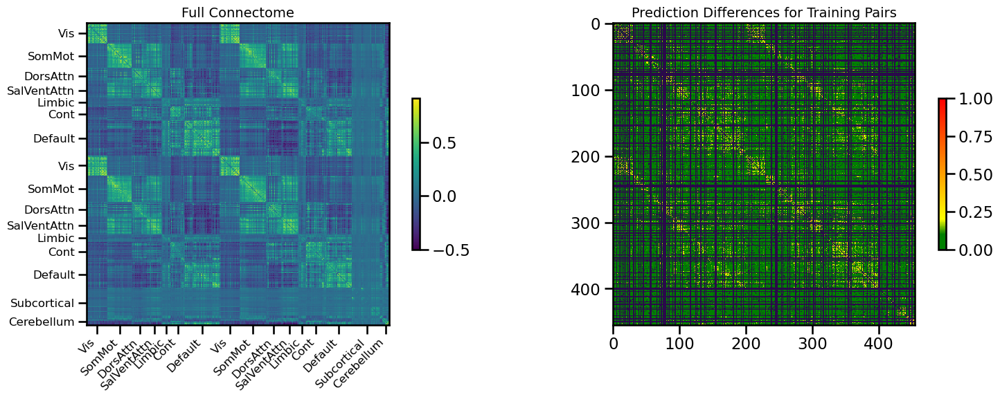

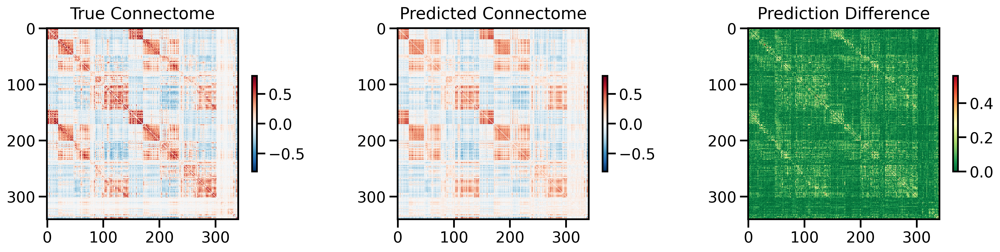

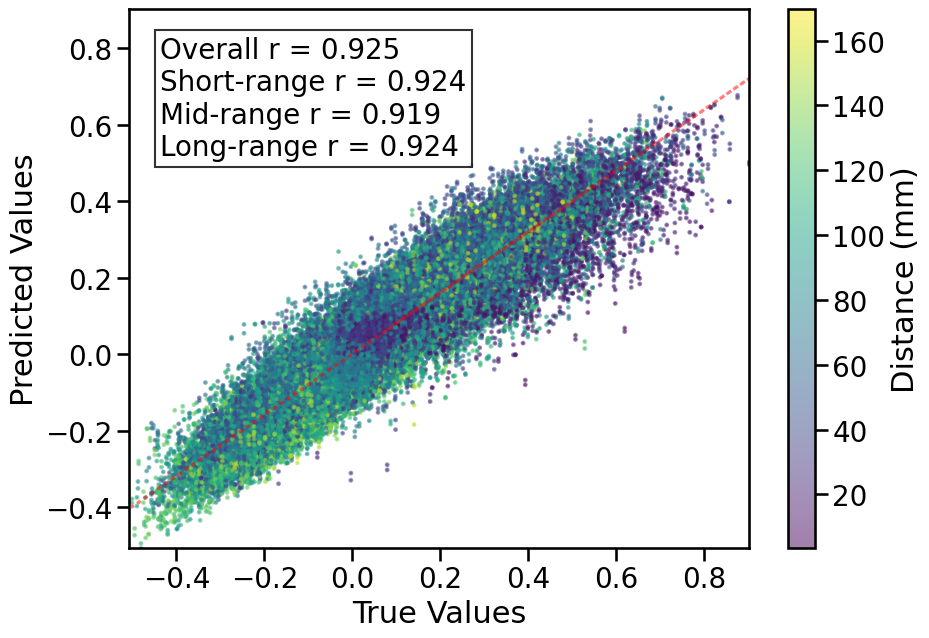

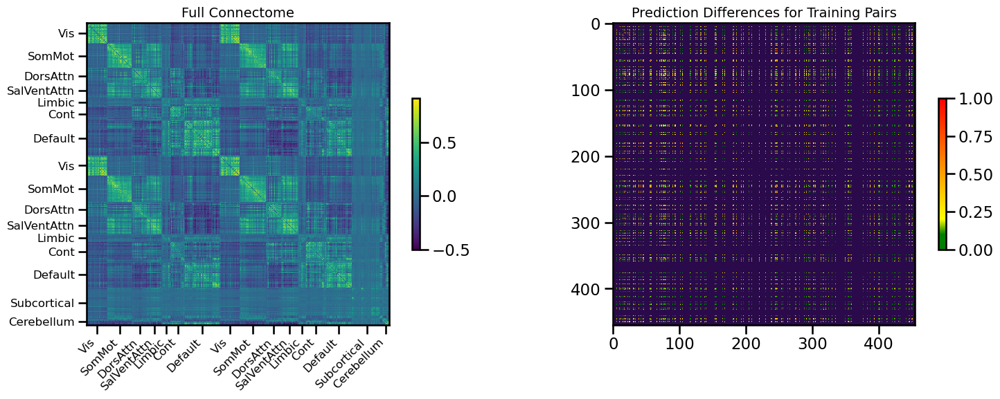

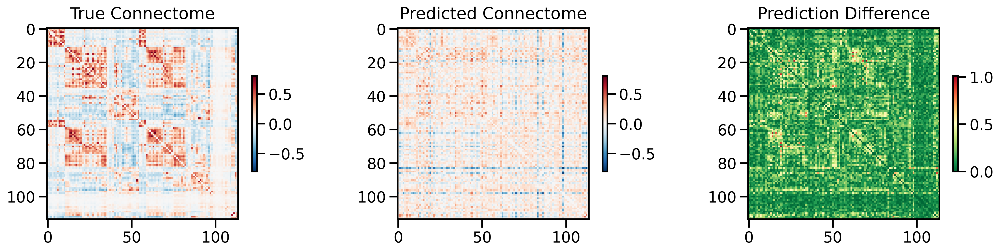

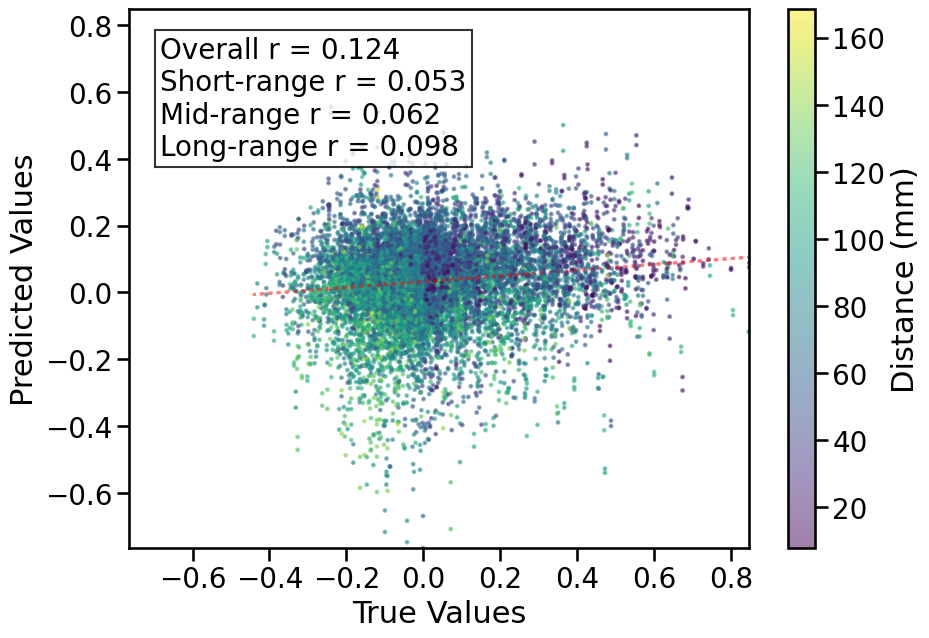


TRAIN METRICS: {'mse': 0.0051225717, 'mae': 0.051704172, 'r2': 0.8513860948386612, 'pearson_r': 0.9248534879182909, 'short_r': 0.923635908476323, 'mid_r': 0.9194629144311273, 'long_r': 0.9235522493258019, 'geodesic_distance': 20.225467205684073}
TEST METRICS: {'mse': 0.0420889, 'mae': 0.1582648, 'r2': -0.31544946670478735, 'pearson_r': 0.12426931722184537, 'short_r': 0.052598675261411695, 'mid_r': 0.06227689400184949, 'long_r': 0.09796123704178213, 'geodesic_distance': 17.335043907271512}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14766, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 24.7%
RAM Usage: 8.0%
Available RAM: 926.6G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 430.60 seconds (7.18 minutes)


37078

In [14]:
single_sim_run(
              feature_type=[{'transcriptome': None}, 
                            {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='random', 
              use_folds=[0])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Transformer with euclidean and randomly shuffled gene expression

permuting gene expression
Number of components for 95% variance PCA: 27
permuting gene expression
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: zatf8ynd
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/zatf8ynd
Initialized sweep with ID: zatf8ynd
2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 70}


  warnings.warn(



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB


  warnings.warn(



Best val loss so far at epoch 1: 0.0329
Best val loss so far at epoch 2: 0.0287
Best val loss so far at epoch 3: 0.0276
Best val loss so far at epoch 4: 0.0258
Best val loss so far at epoch 5: 0.0248
Epoch 5/70, Train Loss: 0.0662, Val Loss: 0.0248, Time: 8.73s
Best val loss so far at epoch 6: 0.0244
Best val loss so far at epoch 7: 0.0234
Best val loss so far at epoch 8: 0.0231
Best val loss so far at epoch 9: 0.0228
Epoch 10/70, Train Loss: 0.0475, Val Loss: 0.0240, Time: 9.45s
Best val loss so far at epoch 11: 0.0223
Best val loss so far at epoch 12: 0.0218
Epoch 15/70, Train Loss: 0.0383, Val Loss: 0.0230, Time: 9.03s
Best val loss so far at epoch 20: 0.0211
Epoch 20/70, Train Loss: 0.0340, Val Loss: 0.0211, Time: 8.79s
Best val loss so far at epoch 21: 0.0204
Epoch 25/70, Train Loss: 0.0255, Val Loss: 0.0215, Time: 8.33s
Best val loss so far at epoch 26: 0.0201
Best val loss so far at epoch 28: 0.0195
Epoch 30/70, Train Loss: 0.0251, Val Loss: 0.0201, Time: 10.05s
Epoch 35/70, Tra

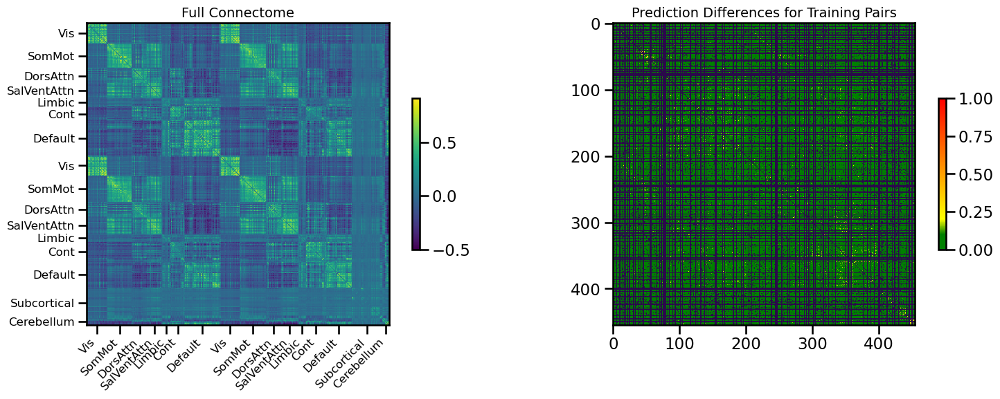

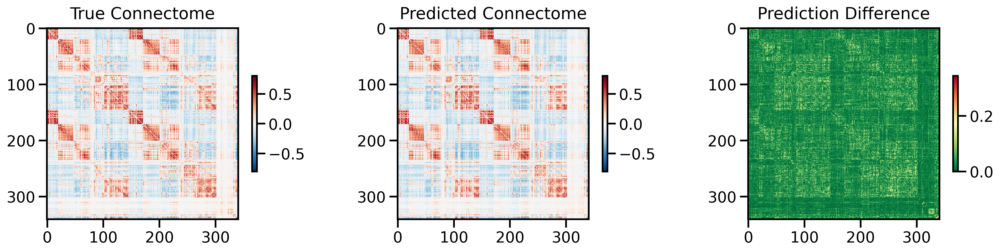

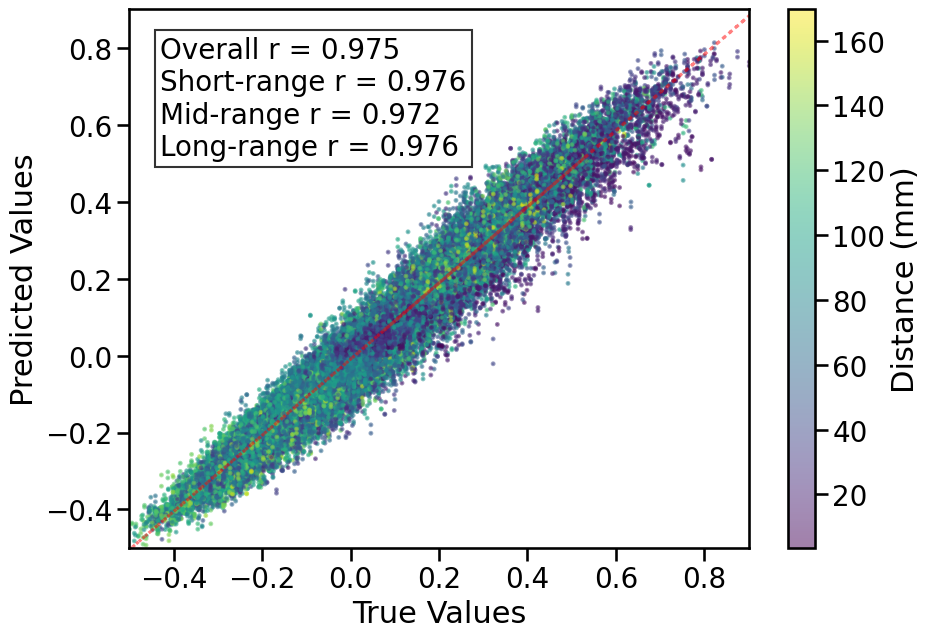

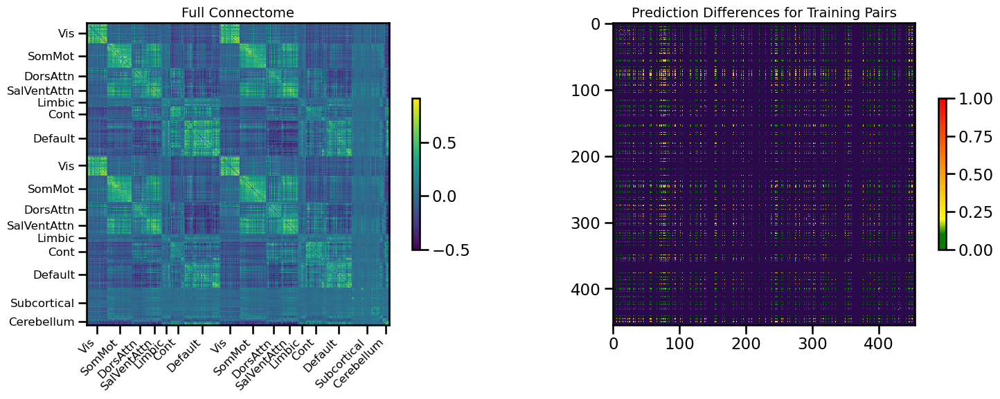

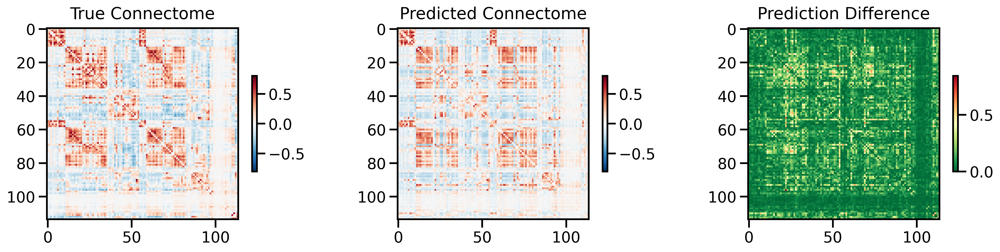

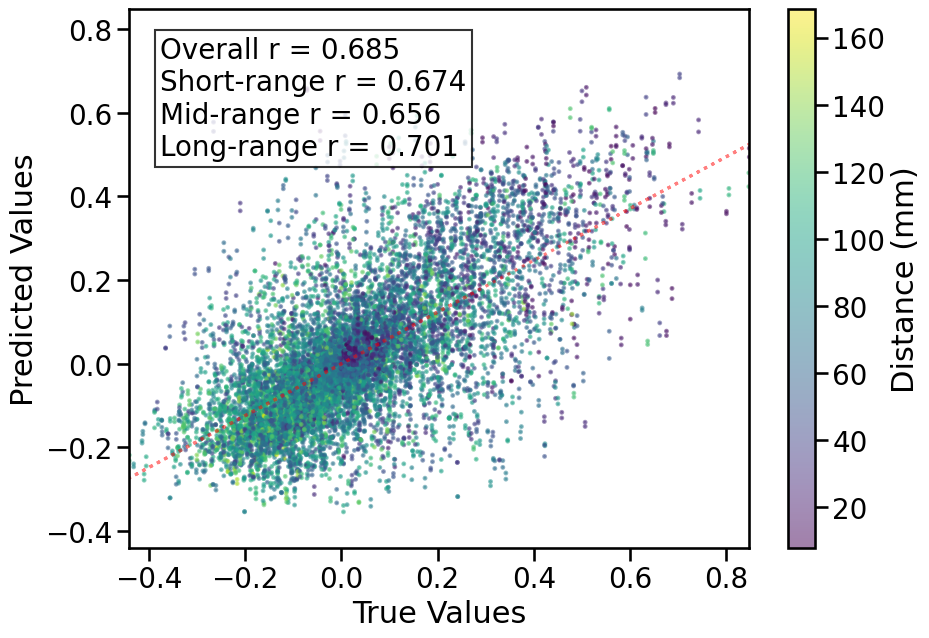


TRAIN METRICS: {'mse': 0.0018294029, 'mae': 0.0317571, 'r2': 0.9469261251627548, 'pearson_r': 0.9752027727133029, 'short_r': 0.9756146502717647, 'mid_r': 0.9722153711368295, 'long_r': 0.9759177137058307, 'geodesic_distance': 14.998719225709603}
TEST METRICS: {'mse': 0.018603403, 'mae': 0.09438844, 'r2': 0.4185678717043291, 'pearson_r': 0.6851433603052867, 'short_r': 0.6736096987204989, 'mid_r': 0.6564249891797552, 'long_r': 0.7009220050847851, 'geodesic_distance': 12.471446935388393}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'cls_init': 'spatial_learned', 'use_alibi': True, 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 70, 'aug_prob': 0.45}
CPU Usage: 4.9%
RAM Usage: 7.5%
Available RAM: 931.2G
Total RAM: 1007

48987

In [15]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='random', 
              use_folds=[0])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

SMT on random shuffle

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='random', 
              use_folds=[0])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

permuting gene expression
Number of components for 95% variance PCA: 27
permuting gene expression
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 7e4f6n96
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/7e4f6n96
Initialized sweep with ID: 7e4f6n96


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 70}
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0383
Best val loss so far at epoch 2: 0.0334
Best val loss so far at epoch 3: 0.0330
Best val loss so far at epoch 4: 0.0323
Best val loss so far at epoch 5: 0.0322
Epoch 5/70, Train Loss: 0.0715, Val Loss: 0.0322, Time: 8.72s
Best val loss so far at epoch 6: 0.0321
Best val loss so far at epoch 7: 0.0320
Epoch 10/70, Train Loss: 0.0564, Val Loss: 0.0320, Time: 8.79s
Best val loss so far at epoch 12: 0.0320
Best val loss so far at epoch 14: 0.0320
Epoch 15/70, Train Loss: 0.0526, Val Loss: 0.0320, Time: 9.10s
Best val loss so far 